# DALI Lab Data Challenge 2025

**Problem: Count the number of barnacles in an image**

A simple to understand, but difficult problem to solve. My notebook below takes a model-based approach to solving the challenge. While I think that an end-to-end model that accurately count barnacles is acheivable, it ended up being much more difficult than I expected. I experiment with traditinoal CV techniques of chunking, thresholding, binarization, and contour detection, as well as SOTA methods using Meta's SAM.

If I were to progress this project with more time, there are several avenues I think would bear fruit, both to improve on my implementation of a method, and to try others. I make a distinction and describe below:

**Improvements to Implementation of Current Methods**
1.   *Define improved metrics to evaluate the quality of classifers.* This is an incredibly important part of the ML engineering pipeline that I only scratched the surface of during my work. I define 4 total metrics with which I can evaluate my model. The first (naive) approach is a pure comparison based on barnacles counted. The 2nd, 3rd, and 4th are more sophisticated (and faithful) metrics of Intersection over Union (IoU), Dice, and Accuracy. As I will mention later, each of these metrics demonstrate a different view of the quality of the model.
2. *Experiment with SAM prompting instead of automatic mask detection.* This is another implementation improvement that I think would bear fruit in improving performance. In the notebook, I use SAM's automatic mask detection, tuned with several hyperparameters that define how the segmentor should operate on our specific image. The biggest issue in this implementation is that SAM finely masks everything in the image, including non-barnacle objects. This leads to a gross overcounting (and increased union) of masks in the image. I think traditional CV methods could be used to filter out some of these erroneous masks —  barnacles tend to be convex, of a certain minimum area, and certainly simply connected (unlike a torus shape). As shown below, the current SAM segmentor has a huge swath of non-barnacle masks. Accordingly, the metrics on it show it has poor performance.
To rememdy this, SAM allows for object mask [prompting](https://github.com/facebookresearch/segment-anything/blob/main/notebooks/predictor_example.ipynb), by specifying a pixel location which is of the object it should segment. If one could roughly do this for barnacles in the image, I think SAM would have a much higher precision on barnacle masks.
3. *More CV techniques and pre-processing.* Barnacles' color, size, shape, and specific features make them extremely identifiable to humans. Though I use several traditional CV techniques, I am sure there are more that I have not experimented with that would make simple contour detection or feature detection for ML models much better.


**Alternative Methods**


1. **Model-based approach:** *Though I tried two extremes from classic CV to pretrained SOTA SAM, I think a traditional ML approach might also be worth attempting.* As mentioned, barnacles have several characteristics that make them identifiable. The reason why the two prior approaches were relatively good fits for this problem was because we did not have an abundance of data to train a prior generation ML model on. But I think there are potential solutions to this issue. Specifically, my idea is to crop the segmentations we do have with a radius of 40 or so pixels around them, to curate a dataset of thousands of barnacles that could then be used to train a more traditional CNN or sklearn classifier. Potentially impementation challenges about what to do with overlapping barnacles and what to use as negative examples exist, but nonetheless I think it is a promising idea.
2. **Visualization based approach:** it's worth considering that a model simply predicting the total number of barnacles in an image may not be the best way to solve the core challenge. If these statistics are especially important, would there even be enough trust from organizations to use the model? What other information do scientists gain from the process of annotating barnacles? Do they scan for disease, sickness, mutation, or other ecological observations that come from manually inspecting barnacles? These are all worthy questions to ask which might lead to a non-model-based approach actually being better. This might be a visualization tool that makes annotation much easier for the biologists, a triaging system that allocates the least confident barnacle segmentations to human annotators, or something that can point out anomalous portions of an image that require a ecological follow-up. This all goes much farther than the black-box model that spits out an integer of barnacles from an image. It would be worth discussing with the clients what solution they think would best augment their workflow.






This preamble adds some conext to the implementation successes and faults in the notebook below. If anything, I enjoyed getting to think about this problem in several different lights, as a researcher, engineer, and with the DALI data team during help hours. With that, the documentation in addition to code provides my commentary on the results of the model. Thanks so much for releasing the challenge and reading my solution!
\- Paul


**Barnacles all seem to be relativley similar in shape, color, and size, so I decided that a simple contour detection algorithm with traditional CV techniques would be a good strategy to begin with.**

In [ ]:
# Import CV libraries
import cv2
import matplotlib.pyplot as plt
import os
import numpy as np

In [ ]:
def split_image(image_path, mask_path, chunk_size):
    """
    Splits a PNG image and its corresponding mask into (n, m) equally sized chunks

    Args:
        image_path (str): Path to the input image
        mask_path (str): Path to the corresponding mask image
        chunk_size (int, int): Tuple specifying the number of row and column chunks (n, m)

    Returns:
        tuple: Two lists - one containing image chunks and the other containing mask chunks
    """
    n, m = chunk_size

    # Read the image and mask
    image = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
    mask_image = cv2.imread(mask_path, cv2.IMREAD_UNCHANGED)

    # Validate that both image and mask are loaded
    if image is None:
        raise ValueError(f"Error loading image from path: {image_path}")
    if mask_image is None:
        raise ValueError(f"Error loading mask from path: {mask_path}")

    # Check for shape mismatch and resize mask if needed
    if mask_image.shape != image.shape:
        print(f"WARNING: Resizing mask from {mask_image.shape} to {image.shape}")
        mask_image = cv2.resize(mask_image, (image.shape[1], image.shape[0]))  # Resize mask to match image dimensions

    # Get image dimensions
    h, w = image.shape[:2]

    # Calculate chunk dimensions
    chunk_h = h // n
    chunk_w = w // m

    chunks = []
    mask_chunks = []

    # Loop through each chunk
    for i in range(n):
        for j in range(m):
            # Define the coordinates of the current chunk
            start_x = j * chunk_w
            end_x = (j + 1) * chunk_w
            start_y = i * chunk_h
            end_y = (i + 1) * chunk_h

            # Crop the image and mask
            chunk = image[start_y:end_y, start_x:end_x]
            mask_chunk = mask_image[start_y:end_y, start_x:end_x]

            # Append chunks to respective lists
            chunks.append(chunk)
            mask_chunks.append(mask_chunk)

    return chunks, mask_chunks


In [ ]:
def preprocess_image(image):
    """
    Preprocesses an image using CLAHE, Gaussian blur, sharpening,
    and binarizes the image

    Args:
        image (numpy.ndarray): Input image (as a numpy array)

    Returns:
        numpy.ndarray: Preprocessed binary image (thresholded and denoised)
    """

    if image is None or image.size == 0:
        raise ValueError("Input image is empty or invalid. Please provide a valid image")

    # Convert to grayscale
    if image.ndim == 3:  # Check for RGB or RGBA
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    elif image.ndim == 2:  # Already grayscale
        gray = image
    else:
        raise ValueError("Unexpected image format. Ensure the input is a valid 2D or 3D array.")

    # pply CLAHE (Contrast Limited Adaptive Histogram Equalization)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    enhanced = clahe.apply(gray)

    # Apply a sharpening filter
    sharpening_kernel = np.array([[0, -1, 0],
                                   [-1, 5, -1],
                                   [0, -1, 0]])
    sharpened = cv2.filter2D(enhanced, -1, sharpening_kernel)

    # Apply Gaussian blur to reduce noise
    blurred = cv2.GaussianBlur(sharpened, (3, 3), 0)

    # Threshold the image using Otsu's method
    _, thresh = cv2.threshold(blurred, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Remove noise
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
    cleaned = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel)

    # Remove small connected components
    num_labels, labels, stats, _ = cv2.connectedComponentsWithStats(cleaned, connectivity=8)
    min_size = 100  # Minimum area to keep a region
    for i in range(1, num_labels):  # Skip the background
        if stats[i, cv2.CC_STAT_AREA] < min_size:
            cleaned[labels == i] = 0

    # Validate output
    if cleaned is None or cleaned.size == 0:
        raise ValueError("Preprocessing failed. The output mask is empty")

    return cleaned


In [ ]:
def evaluate_mask_similarity(predicted_mask, ground_truth_mask):
    """
    Evaluates the similarity between a predicted mask and a ground truth mask

    Args:
        predicted_mask (numpy.ndarray): Binary mask from contours (0 or 255)
        ground_truth_mask (numpy.ndarray): Ground truth binary mask (0 or 255)

    Returns:
        dict: Dictionary containing IoU, Dice coefficient, and pixel accuracy
    """
    # Ensure masks are binary (0 and 1)
    predicted_mask = (predicted_mask > 0).astype(np.uint8)
    ground_truth_mask = (ground_truth_mask > 0).astype(np.uint8)

    # Compute intersection and union
    intersection = np.logical_and(predicted_mask, ground_truth_mask).sum()
    union = np.logical_or(predicted_mask, ground_truth_mask).sum()

    # Compute IoU
    iou = intersection / union if union > 0 else 0

    # Compute Dice coefficient
    dice = (2 * intersection) / (predicted_mask.sum() + ground_truth_mask.sum()) if (predicted_mask.sum() + ground_truth_mask.sum()) > 0 else 0

    # Compute Pixel Accuracy
    accuracy = np.mean(predicted_mask == ground_truth_mask)

    return {
        'IoU': iou,
        'Dice': dice,
        'Accuracy': accuracy
    }


In [ ]:
def count_barnacles_traditional_chunk(image, mask):
    """
    Counts barnacles in an image using contour detection on a preprocessed image
    and evaluates similarity with a ground truth mask

    Args:
        image (numpy.ndarray): Input image chunk (as a numpy array)
        mask (numpy.ndarray): Ground truth mask chunk (as a numpy array)

    Returns:
        int: Number of barnacles detected.
        dict: 3 similarity metrics between the predicted and true mask
    """
    min_area = 100

    # Preprocess the input image to generate  binary mask
    thresh = preprocess_image(image)

    # Validate thresholded image
    if thresh is None or thresh.size == 0:
        raise ValueError("Thresholded image is empty or invalid. Please check the preprocessing step")

    # Find contours in mask
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Get rid of small contours
    filtered_contours = [cnt for cnt in contours if cv2.contourArea(cnt) > min_area]

    # Overlay contours on original image
    output = image.copy()
    cv2.drawContours(output, filtered_contours, -1, (0, 255, 0), 1)

    # Count contours = # barnacles
    barnacle_count = len(filtered_contours)
    print(f"Number of barnacles detected: {barnacle_count}")

    # Plot
    plt.figure(figsize=(10, 6))
    plt.subplot(1, 2, 1)
    plt.title('Thresholded Image')
    plt.imshow(thresh, cmap='gray')

    plt.subplot(1, 2, 2)
    plt.title(f'Detected Barnacles: {barnacle_count}')
    plt.imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB))
    plt.show()

    # Convert the mask to color
    if mask.ndim == 3:  # Check for RGB or RGBA
        if mask.shape[-1] == 4:  # RGBA
            mask = cv2.cvtColor(mask, cv2.COLOR_RGBA2GRAY)
        else:  # RGB
            mask = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)

    _, mask = cv2.threshold(mask, 127, 255, cv2.THRESH_BINARY)

    # Make sure both are binary formatted to compare
    predicted_mask = (thresh > 0).astype(np.uint8)
    ground_truth_mask = (mask > 0).astype(np.uint8)

    # Evaluate similarity between the pred and true mask
    metrics = evaluate_mask_similarity(predicted_mask, ground_truth_mask)

    return barnacle_count, metrics


In [ ]:
def combine_metrics(chunk_metrics):
    """
    Combines metrics from all chunks by averaging
    Args:
        chunk_metrics (list of dict): List of dict containing metrics for chunks

    Returns:
        dict: Dictionary of averaged metrics
    """

    combined = {'IoU': 0, 'Dice': 0, 'Accuracy': 0}
    num_chunks = len(chunk_metrics)

    # Sum all metrics across chunks
    for metrics in chunk_metrics:
        for key in combined:
            combined[key] += metrics[key]

    # Average the metrics
    for key in combined:
        combined[key] /= num_chunks

    return combined

In [ ]:
def traditional_full_counter(image_path, mask_path, chunk_size, min_area=30):
    """
    Splits the image, counts barnacles, with traditional CV methods, then returns
    a total count and metric list

    Args:
        image_path (str): Path to the full-resolution input image
        mask_path (str): Path to the mask image corresponding to the input image
        chunk_size (int, int): m by n chunk size
        min_area (int): min area to count mask

    Returns:
        tot_barnacles (int): total # of counter barnacles
        metric_list (list of dict): list of metrics for each chunk
    """

    # Split the image and mask into chunks
    chunks, mask_chunks = split_image(image_path, mask_path, chunk_size)

    tot_barnacles = 0
    metric_list = []

    # For each chunk, count barnacles and store metrics
    for i in range(len(chunks)):
        chunk_barn, metric_dict = count_barnacles_traditional_chunk(chunks[i], mask_chunks[i])
        metric_list.append(metric_dict)
        tot_barnacles += chunk_barn

    return tot_barnacles, metric_list


## Simple Approach on Image 1

Number of barnacles detected: 100


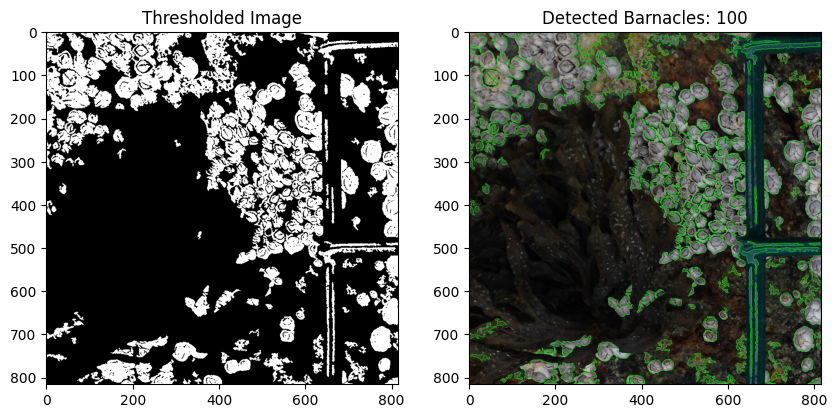

Number of barnacles detected: 139


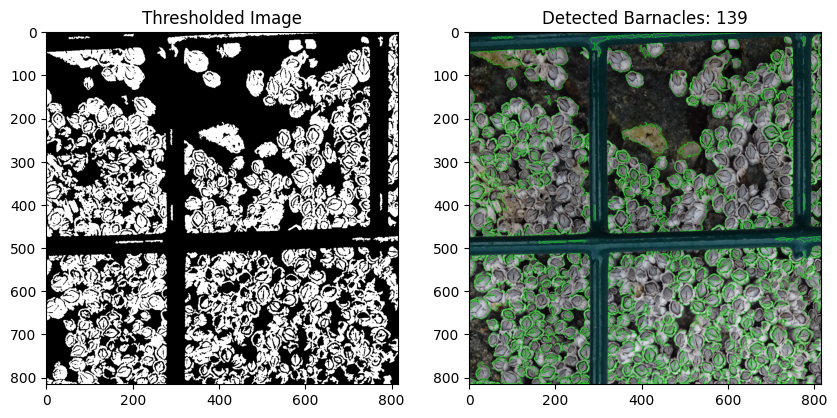

Number of barnacles detected: 264


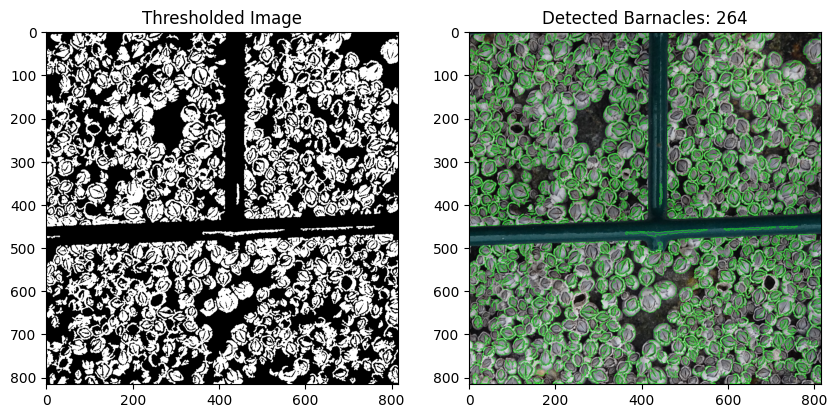

Number of barnacles detected: 102


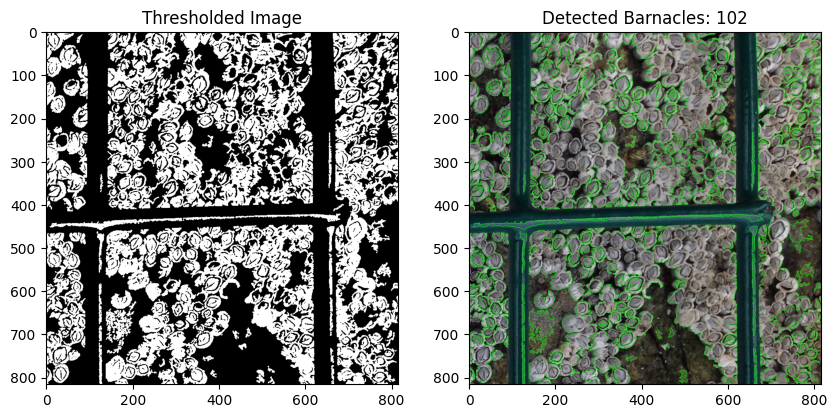

Number of barnacles detected: 120


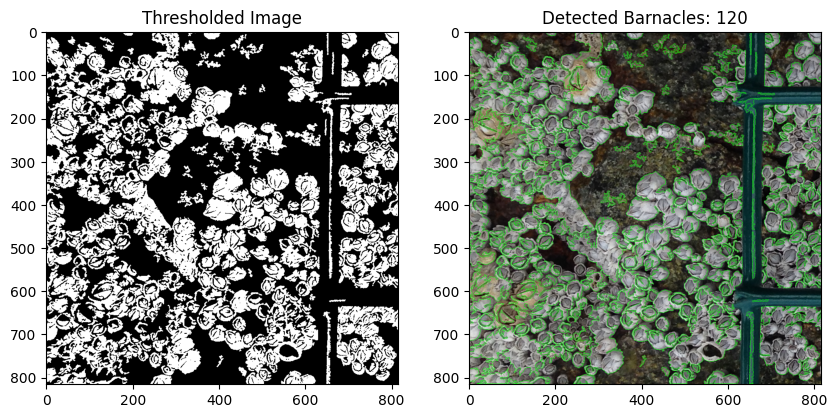

Number of barnacles detected: 218


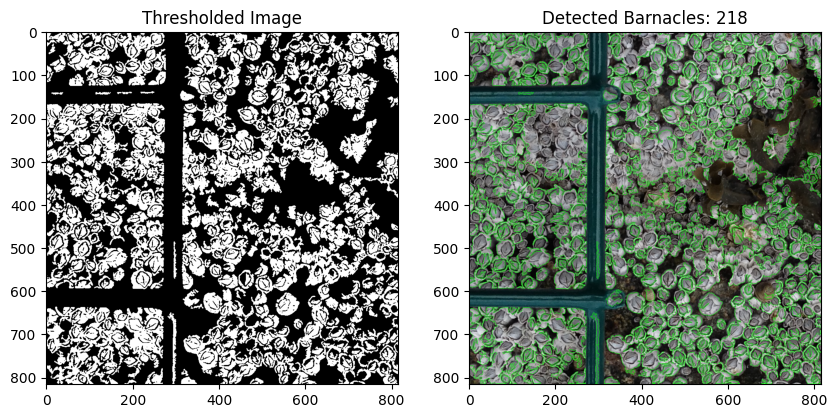

Number of barnacles detected: 259


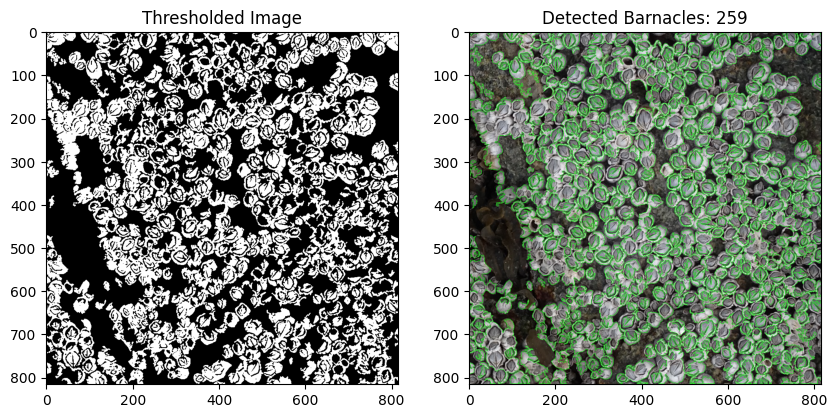

Number of barnacles detected: 103


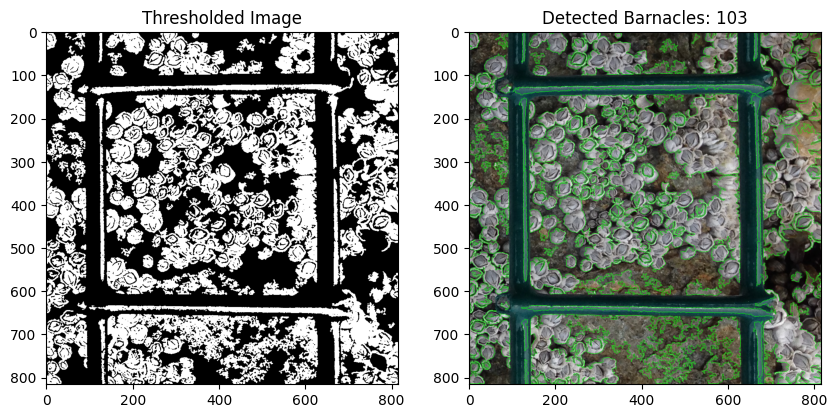

Number of barnacles detected: 95


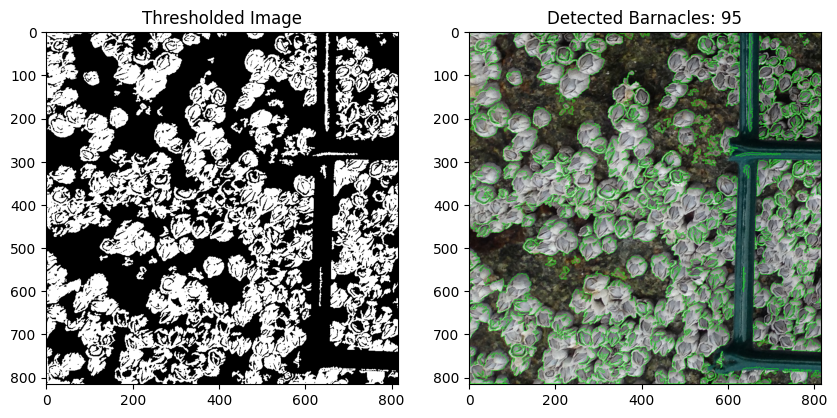

Number of barnacles detected: 98


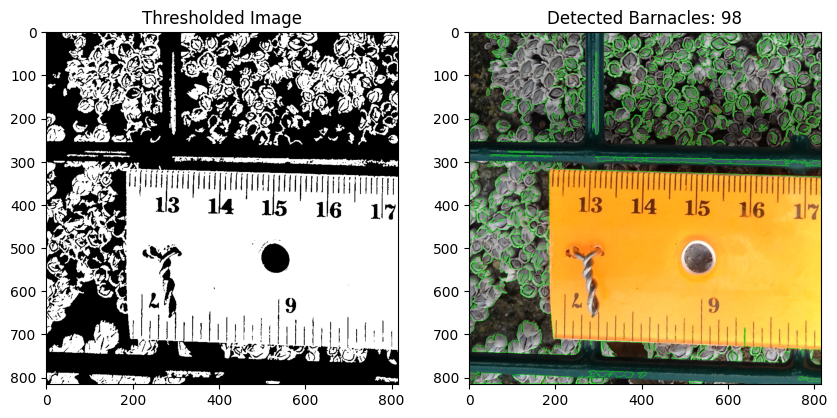

Number of barnacles detected: 110


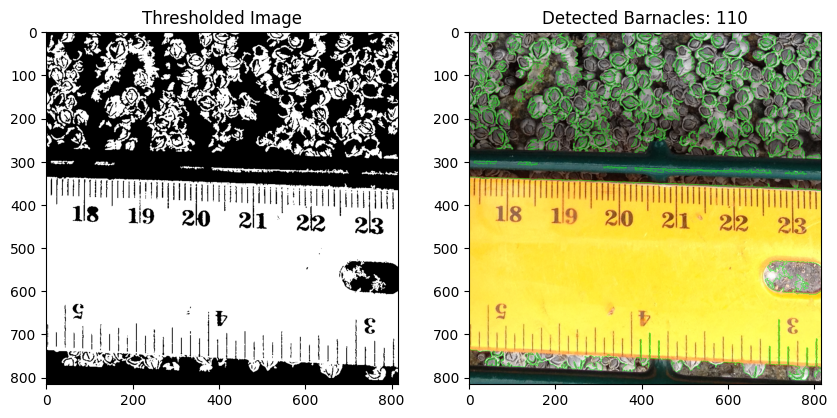

Number of barnacles detected: 111


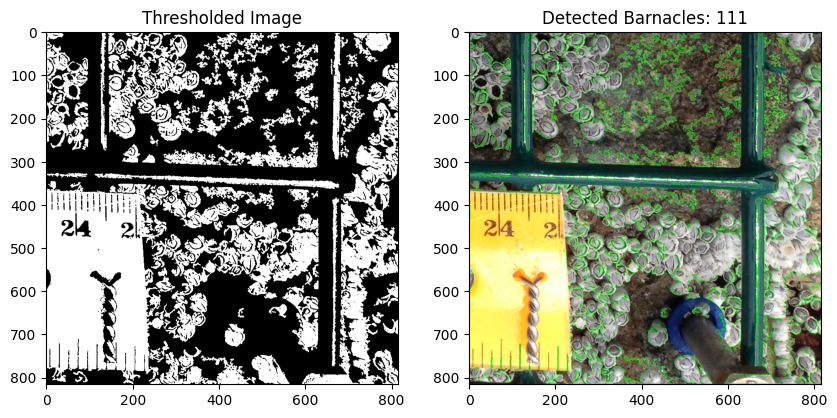

In [ ]:
image_path = "/content/img1.png"
mask_path = "/content/masked_img1.png"
chunk_size = (3,4)
tot_barnacles, metric_list = traditional_full_counter(image_path, mask_path, chunk_size)

In [ ]:
print(f"Total barnacles in image: {tot_barnacles}")
combined_metrics = combine_metrics(metric_list)
print(combined_metrics)

Total barnacles in image: 1719
{'IoU': 0.19169186420229634, 'Dice': 0.32031010093940027, 'Accuracy': 0.5203458655725363}


As the metric dictionary shows, while qualitatively it might seem like the model has some merit in segmenting barnacles, the more advanced statistics demonstrate that it is overclassifying. The extremely low IoU exemplifies this. What can be done to fix these errors? Since relatively well-known preprocessing techniques are being used in the contour detection, I think the next step to take would be filtering the masks after the fact. I am sure there is a lot of mileage to be gained by trying to filter this overextended list of its concave masks, irregularily shapen masks, torus-like masks.

In addition to traditional CV methods, I also wanted to try the other extreme: a massive state-of-the-art pretrained model. Specifically, Meta AI's Segment Anything Model, otherwise known as SAM.

Why not use other traditional machine learning methods like CNNs for instance? For me, the biggest issue with trying solutions from a prior generation of ML was the scarcity of labelled data for this problem. As mentioned before, I'm sure it is possible to circumnavigate this challenge with data augmentation techniques and cropping our two labelled masks into several hundred. For me, however, I thought it would be more interesting to jump to the frontier and implement a state-of-the-art model like SAM.


**Knowing how well SAM can zero-shot segment images, I decided to try it out in combination with the traditional Computer Vision preprocessing techniques that we used above for contour detection.** The hope was that the preprocessing would be useful feature extraction for SAM

The below code is written with Meta's [documentation](https://github.com/facebookresearch/segment-anything) on how to implement automatic mask prediction with SAM 2.

In [ ]:
using_colab = True
if using_colab:
    import torch
    import torchvision
    print("PyTorch version:", torch.__version__)
    print("Torchvision version:", torchvision.__version__)
    print("CUDA is available:", torch.cuda.is_available())
    import sys
    !{sys.executable} -m pip install opencv-python matplotlib
    !{sys.executable} -m pip install 'git+https://github.com/facebookresearch/segment-anything.git'

    !mkdir images
    !wget -P images https://raw.githubusercontent.com/facebookresearch/segment-anything/main/notebooks/images/dog.jpg

    !wget https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth

PyTorch version: 2.5.1+cu121
Torchvision version: 0.20.1+cu121
CUDA is available: True
  Cloning https://github.com/facebookresearch/segment-anything.git to /tmp/pip-req-build-zdm5lolo
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/segment-anything.git /tmp/pip-req-build-zdm5lolo
  Resolved https://github.com/facebookresearch/segment-anything.git to commit dca509fe793f601edb92606367a655c15ac00fdf
  Preparing metadata (setup.py) ... done
mkdir: cannot create directory ‘images’: File exists
--2025-01-24 04:42:35--  https://raw.githubusercontent.com/facebookresearch/segment-anything/main/notebooks/images/dog.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 99846 (98K) [image/jpeg]
Saving to: ‘images/dog.jpg.1’

dog

In [ ]:
import sys
import cv2
import numpy as np
import matplotlib.pyplot as plt

from segment_anything import sam_model_registry, SamAutomaticMaskGenerator

def show_anns(anns):
    if len(anns) == 0:
        return
    sorted_anns = sorted(anns, key=(lambda x: x['area']), reverse=True)
    ax = plt.gca()
    ax.set_autoscale_on(False)

    img = np.ones((sorted_anns[0]['segmentation'].shape[0], sorted_anns[0]['segmentation'].shape[1], 4))
    img[:,:,3] = 0
    for ann in sorted_anns:
        m = ann['segmentation']
        color_mask = np.concatenate([np.random.random(3), [0.35]])
        img[m] = color_mask
    ax.imshow(img)

In [ ]:
def count_barnacles_sam_chunk(
    chunk,
    true_mask,
    sam_checkpoint="sam_vit_h_4b8939.pth",
    model_type="vit_h",
    device="cuda"
):
    """
    Uses SAM to predict barnacles on a chunk. Comares to corresponding true mask passed

    Args:
        chunk (numpy.ndarray): Input image chunk
        true_mask (numpy.ndarray): Ground truth binary mask chunk
        sam_checkpoint (str): Path to the SAM checkpoint file
        model_type (str): SAM model type
        device (str): Device to run the model on ("cuda" or "cpu")

    Returns:
        tuple (int, dict): num_barnacles counted and stats dictionary
    """
    # Load SAM model
    sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
    sam.to(device)

    # Define SAM's mask generator with desired parameters
    mask_generator = SamAutomaticMaskGenerator(
        model=sam,
        points_per_side=30,
        pred_iou_thresh=0.9,
        stability_score_thresh=0.92,
        crop_n_layers=1,
        crop_n_points_downscale_factor=2,
        min_mask_region_area=650  # Requires OpenCV for post-processing
    )

    # Convert from BGR to RGB if needed
    rgb_chunk = cv2.cvtColor(chunk, cv2.COLOR_BGR2RGB)

    # Generate masks on this chunk
    masks = mask_generator.generate(rgb_chunk)

    # Combine all masks into a single binary mask (SAM's predicted mask)
    predicted_mask = np.zeros(rgb_chunk.shape[:2], dtype=np.uint8)
    for mask in masks:
        predicted_mask[mask['segmentation']] = 1

    # Resize the ground truth mask to match the dimensions of the predicted mask
    if true_mask.shape[:2] != predicted_mask.shape:
        true_mask_resized = cv2.resize(true_mask, (predicted_mask.shape[1], predicted_mask.shape[0]))
    else:
        true_mask_resized = true_mask

    # Convert true mask to grayscale and binary format
    if true_mask_resized.ndim == 3:  # Check for RGB or RGBA
        if true_mask_resized.shape[-1] == 4:  # RGBA
            true_mask_resized = cv2.cvtColor(true_mask_resized, cv2.COLOR_RGBA2GRAY)
        else:  # RGB
            true_mask_resized = cv2.cvtColor(true_mask_resized, cv2.COLOR_BGR2GRAY)
    _, true_mask_resized = cv2.threshold(true_mask_resized, 127, 255, cv2.THRESH_BINARY)
    true_mask_resized = (true_mask_resized > 0).astype(np.uint8)

    # Evaluate mask similarity
    metrics = evaluate_mask_similarity(predicted_mask, true_mask_resized)

    # plot
    plt.figure(figsize=(10, 10))
    plt.imshow(chunk)    # Show original chunk
    show_anns(masks)     # Overlay segmentation masks
    plt.axis('off')
    plt.show()

    # Return the number of masks and evaluation metrics
    return len(masks), metrics


In [ ]:
def sam_full_counter(image_path, mask_path, chunk_size):
    """
    Uses SAM to count barnacles across an image. Compares to mask and returns statistics
    Args:
        image_path (str): Path to the input image
        mask_path (str): Path to the mask image
        chunk_size (int, int): Size of chunks

    Returns:
        tuple (int, list of dicts): total barnacles, stats dict
    """
    # Split the image and mask into chunks
    chunks, mask_chunks = split_image(image_path, mask_path, chunk_size)

    tot_barnacles = 0
    metric_list = []

    # Process each chunk with SAM to count barnacles and calculate metrics
    for i in range(len(chunks)):
        chunk = chunks[i]
        mask_chunk = mask_chunks[i]
        barn_chunk, metrics = count_barnacles_sam_chunk(
            chunk,
            mask_chunk,
            sam_checkpoint="sam_vit_h_4b8939.pth",
            model_type="vit_h",
            device="cuda"
        )
        tot_barnacles += barn_chunk
        metric_list.append(metrics)

    return tot_barnacles, metric_list


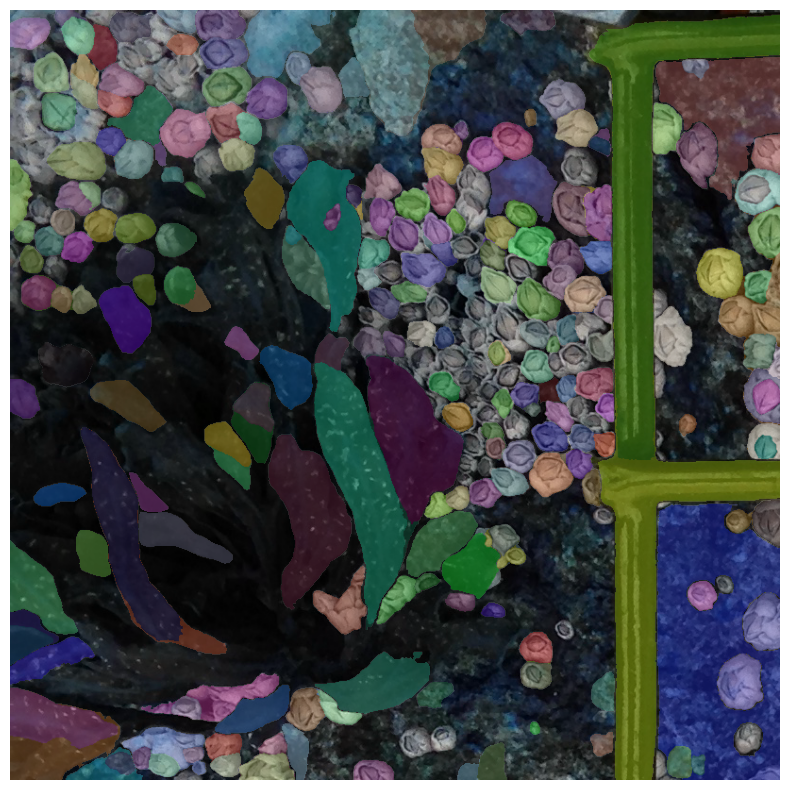

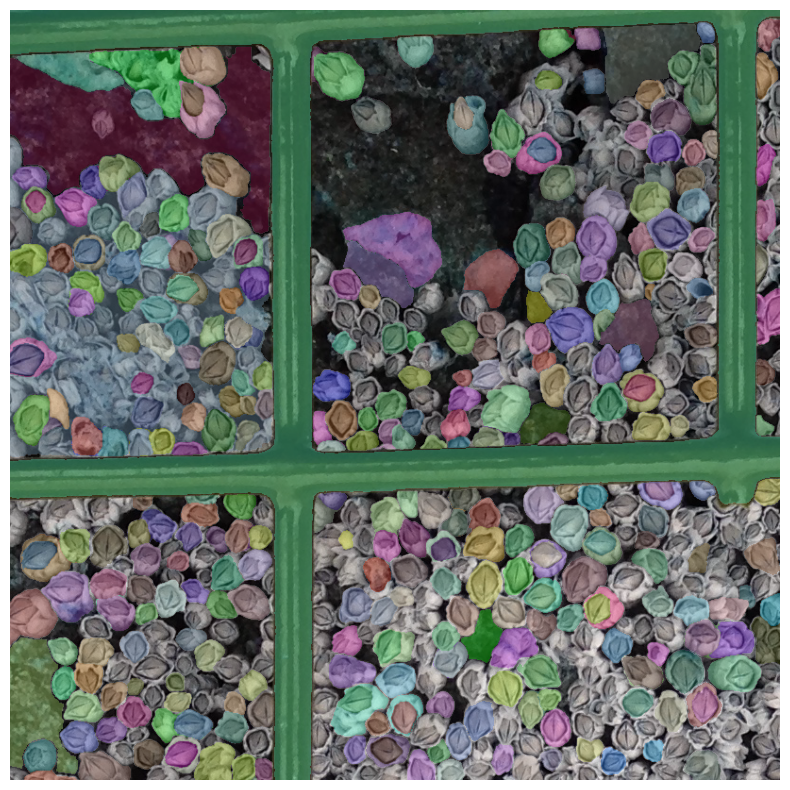

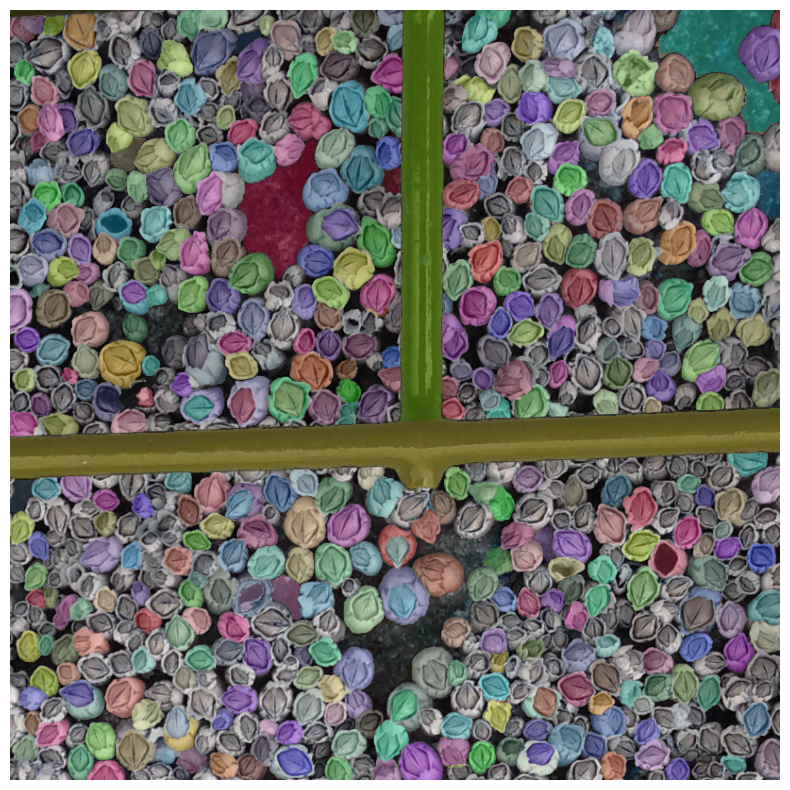

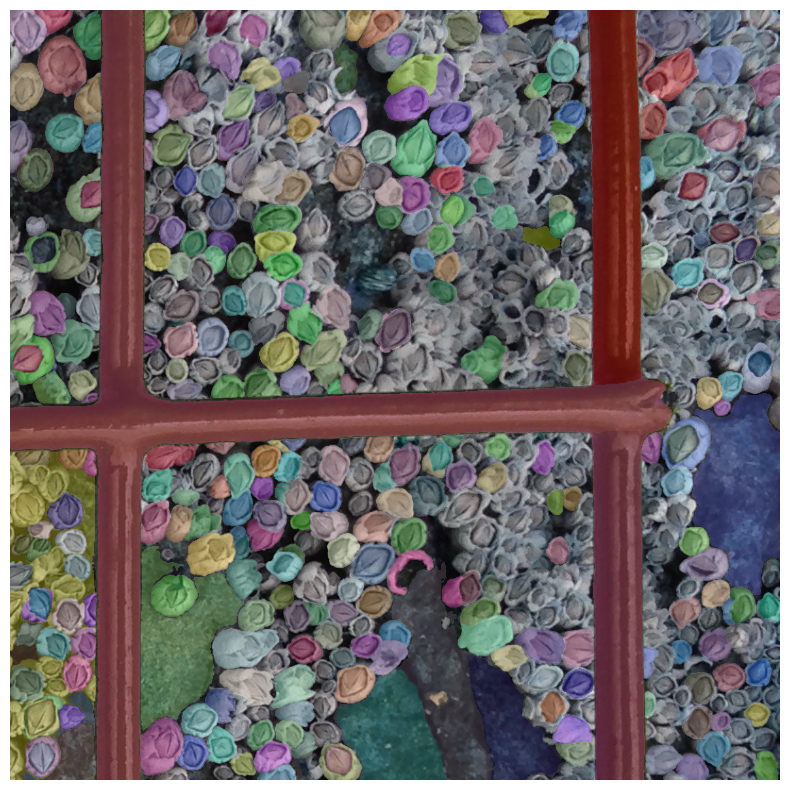

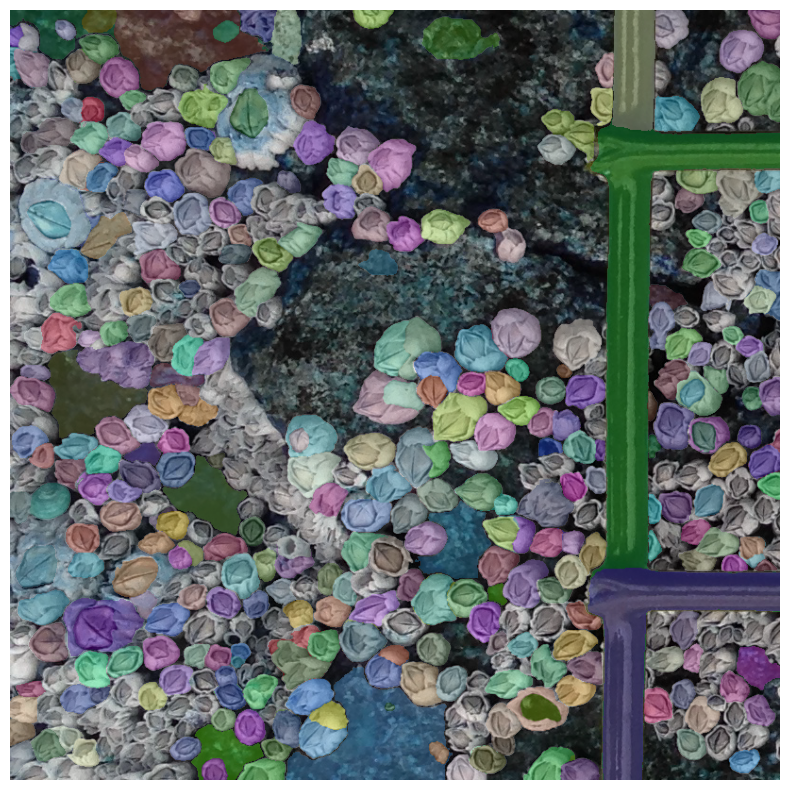

...

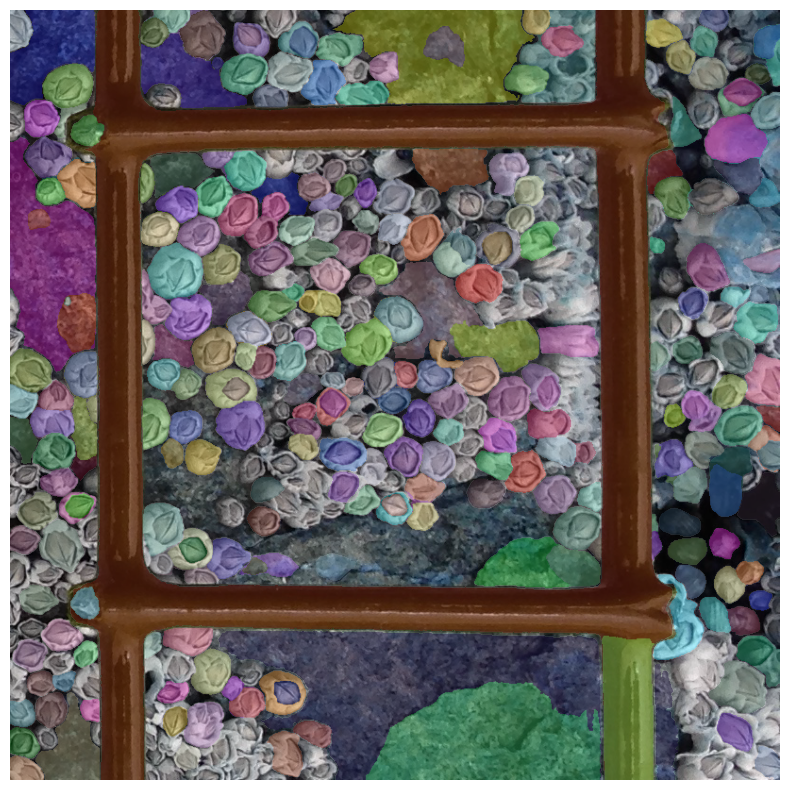

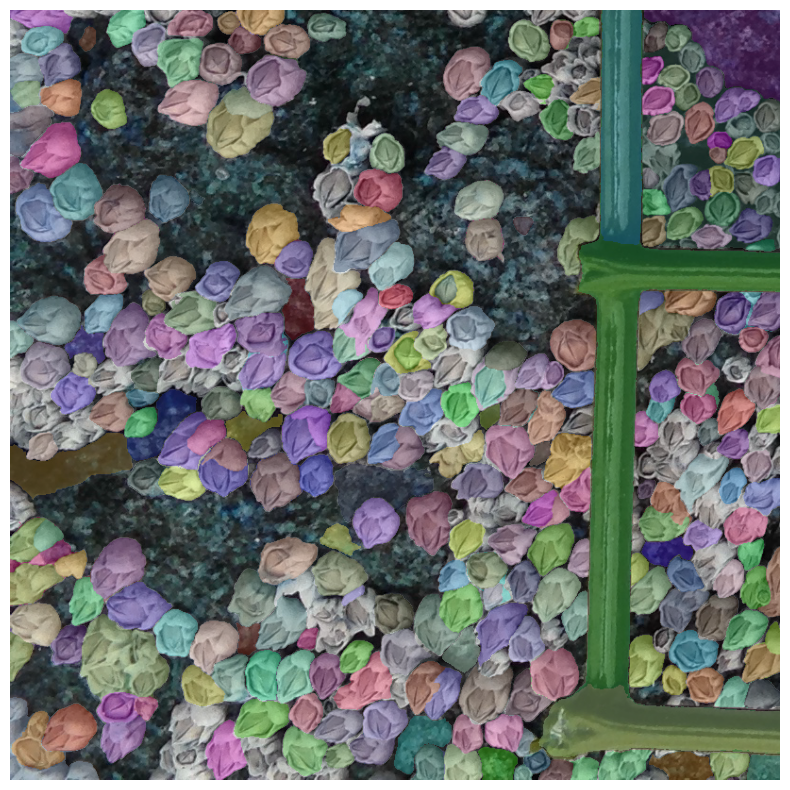

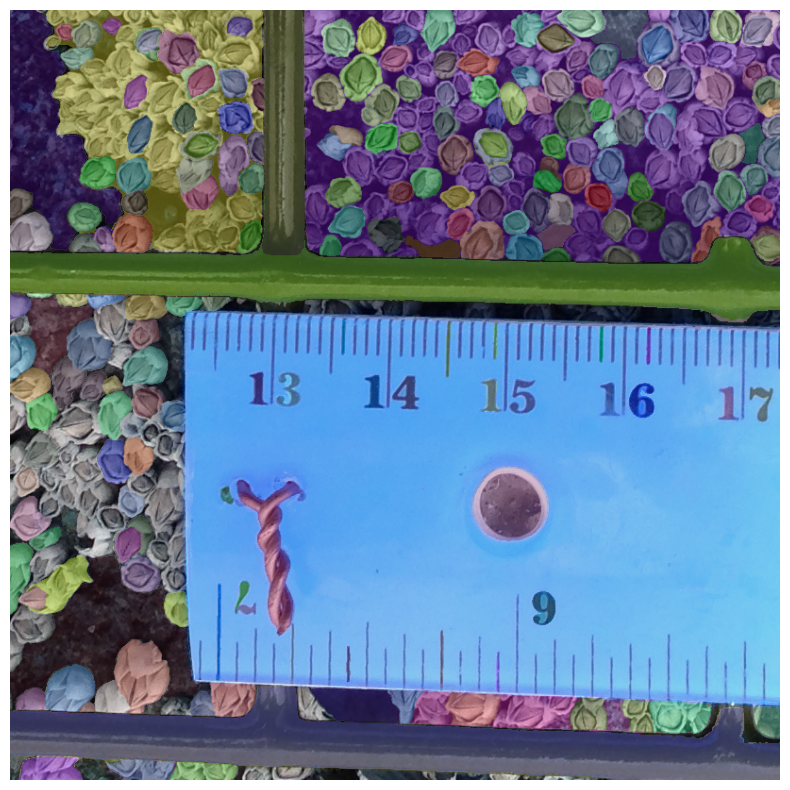

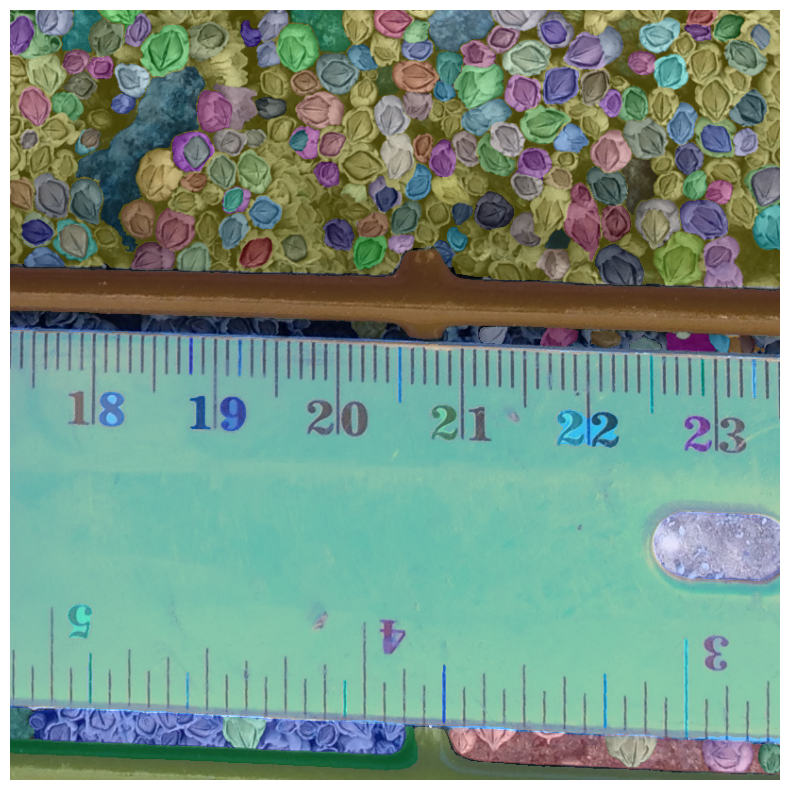

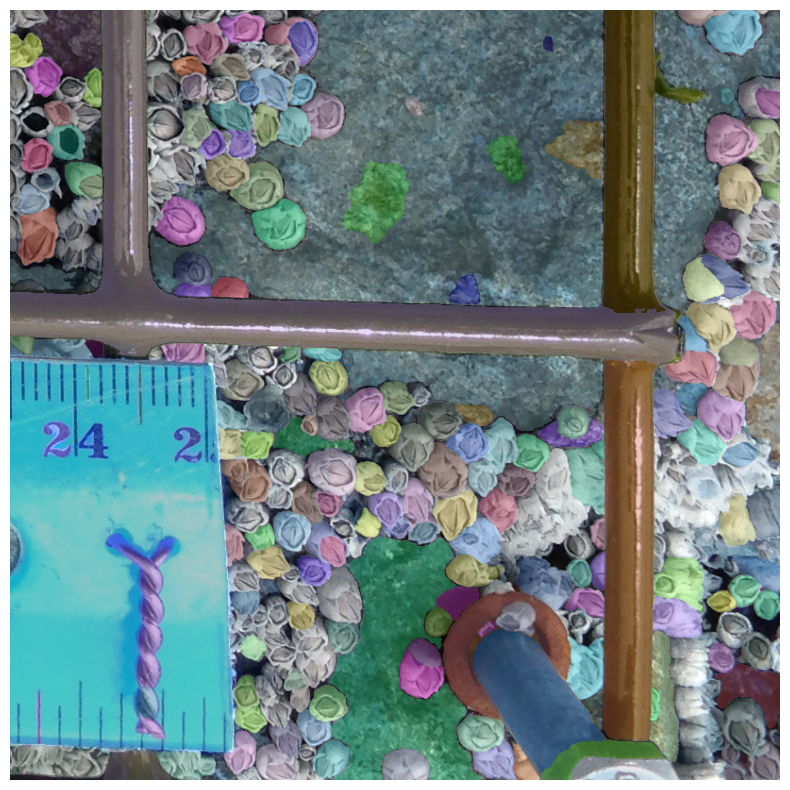

In [ ]:
tot_barnacles, metric_list = sam_full_counter(image_path, mask_path, chunk_size=(3,4))

In [ ]:
print(tot_barnacles)
combined_metrics = combine_metrics(metric_list)
print(combined_metrics)

3872
{'IoU': 0.23745525117585697, 'Dice': 0.38120938029814905, 'Accuracy': 0.40265225013616557}


As demonstrated in the statistics, this aso performed sub-par. There are many over-segmentations in the barnacles' inner and outer shell. Interestingly, the segmenter seems to be relatively inconsistent even in similar scenarios. Some images have barnacles segmented with high granularity, but in others it completely misses massive groups of barnacles or treats them as one entity. Ultimately, as mentioned in the preamble, I think this method (currently using automated mask detection) would benefit from a prompting technique to focus the model's segmentations. Additionally, mask filtering based on inherent properites of barnacles would reduce the number of missegmentations.

**Conclusions**

This project was certainly a learning experience on my ML engineering journey. Taking this problem, and attempting two solutions on opposite ends of a technological spectrum was extremely fun - even if only to generate sub-par classifications. Reflecting on how I could have changed my process, I think focusing on first creating high quality metrics, and then methods would have beeb extremely beneficial. I actually think that choosing one implementation strategy and focusing on the specific data and filtering engineering challenges would have made for a better outcome - in essence, looking toward depth in one solution rather than breadth in many. Though, as I have noted, there is ample room for improvment in the implementation in the two strategies I tried, if I were to continue working on this problem, I would explore other areas as well (before eventually choosing one to drill into). Traditional ML CNN models with high quality data augmentation seems like a promising ML pipeline in addition to taking a more wholistic view of the issue at hand with input from the clients for a visualization/human-interactive solution. As a ML enthusiast it was a blast to take even just a cursory stab at this problem for DALI! I'd love to hear what your solution actually was and, perhaps more importantly, how you iterated and developed your process to find it!